# Imports

In [ ]:
# Standard libraries
import os
import joblib

# Data handling
import pandas as pd
import numpy as np

# Machine learning
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Geospatial
import geopandas as gpd
from shapely.geometry import Polygon
from shapely import wkt
import contextily as ctx  # for background basemap tiles

# Visualization
import matplotlib.pyplot as plt
import folium
import branca.colormap as cm
from IPython.display import HTML

# Explainable AI
import shap

# Data preprocessing

### Prepare earthquake data

In [2]:
col_names = ['Date', 'Time', 'Event Type', 'GT', 'Magnitude', 'Magnitude Type', 'Latitude', 'Longitude', 'Depth', 'Quality', 'Event ID', 'Number of Picked Phases', 'Ngrams']

all_eq = []

for year in range(1977, 2019): # Exclude years not in wells data
    filename = f'data/raw/SCEC_DC/{year}.catalog'

    eq = pd.read_csv(filename, sep=r'\s+', comment='#', header=None, names=col_names)

    eq['Datetime'] = pd.to_datetime(eq['Date'] + ' ' + eq['Time'], errors='coerce') # Invalid entries set as NaT
    eq['Year'] = year

    all_eq.append(eq)

eqs = pd.concat(all_eq, ignore_index=True)
eqs.to_csv('data/processed/earthquakes.csv', index=False)

In [3]:
eqs = pd.read_csv('data/processed/earthquakes.csv')
eqs.head()

,Date,Time,Event Type,GT,Magnitude,Magnitude Type,Latitude,Longitude,Depth,Quality,Event ID,Number of Picked Phases,Ngrams,Datetime,Year
0,1977/01/01,01:00:31.80,eq,l,2.93,l,34.458,-117.960,4.3,A,3332247,45,85,1977-01-01 01:00:31.800,1977
1,1977/01/01,01:25:23.91,eq,l,1.50,h,34.363,-118.674,19.0,C,3332248,10,13,1977-01-01 01:25:23.910,1977
2,1977/01/01,04:39:33.12,eq,l,1.60,h,32.809,-115.503,6.8,C,3332249,8,13,1977-01-01 04:39:33.120,1977
3,1977/01/01,10:36:07.61,eq,l,1.99,h,34.143,-117.455,0.0,A,3332250,50,44,1977-01-01 10:36:07.610,1977
4,1977/01/01,12:08:39.70,eq,l,1.80,h,35.271,-118.604,4.8,B,3332251,10,14,1977-01-01 12:08:39.700,1977


### Prepare well injections data

In [ ]:
# Obtain the API numbers to loop through
api_filepath = 'data/raw/dataAllFields/WellsAPInumber.dat'

with open(api_filepath, 'r') as f:
    wells_api = [line.strip() for line in f]

all_injs = []

for api in wells_api:
    filepath = f'data/raw/dataAllFields/Well_Injection_API_{api}.xlsx'
    well_metadata = pd.read_excel(filepath, nrows=1)
    injection_data = pd.read_excel(filepath, skiprows=3)

    # Drop columns in injection_data containing 'Unnamed'
    drop_cols = injection_data.columns[injection_data.columns.str.contains('Unnamed')]
    injection_data.drop(drop_cols, axis=1, inplace=True)

    # Handle case when there are no rows in injection_data - set all column values as NA
    if injection_data.empty:
        injection_data = pd.DataFrame({col: pd.Series([pd.NA], dtype='object') for col in injection_data.columns})

    # Duplicate well_metadata rows to match number of rows of injection_data
    well_md = pd.concat([well_metadata]*len(injection_data), ignore_index=True)

    # Final concatenation
    injection = pd.concat([well_md, injection_data], axis=1)

    all_injs.append(injection)

injs = pd.concat(all_injs, ignore_index=True)

# Convert columns into correct dtypes
injs = injs.convert_dtypes()

injs.to_csv('data/processed/well_injections.csv', index=False)

In [4]:
inj = pd.read_csv('data/processed/well_injections.csv', low_memory=False)
inj.head()

,API #,Operator Name,County Name,Field Name,Lease Name,Well #,Area Name,Area Code,District #,Section,...,Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,PWT Status,Well Type,Status,Pool Code,Reported Date
0,2500001,Mike Barkett,Imperial,Any Field,Barkett,2,Any Area,0,1,20,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2500002,Clarence E. Harrison,Imperial,Any Field,Yuha,1,Any Area,0,1,20,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2500003,Petrodynamics Assoc.,Imperial,Any Field,Straw,1,Any Area,0,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2500004,Sardi Oil Co.,Imperial,Any Field,Biff,1,Any Area,0,1,24,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2500005,Ajax Oil and Development Co.,Imperial,Any Field,U.S.L. Phyllis,1,Any Area,0,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Prepare well production data

In [ ]:
# Obtain the API numbers to loop through
api_filepath = 'data/raw/dataAllFields/WellsAPInumber.dat'

with open(api_filepath, 'r') as f:
    wells_api = [line.strip() for line in f]

all_prod = []

for api in wells_api:
    filepath = f'data/raw/dataAllFields/Well_Production_API_{api}.xlsx'
    well_metadata = pd.read_excel(filepath, nrows=1)
    production_data = pd.read_excel(filepath, skiprows=3)

    # Drop columns in production_data containing 'Unnamed'
    drop_cols = production_data.columns[production_data.columns.str.contains('Unnamed')]
    production_data.drop(drop_cols, axis=1, inplace=True)

    # Handle case when there are no rows in production_data - set all column values as NA
    if production_data.empty:
        production_data = pd.DataFrame({col: pd.Series([pd.NA], dtype='object') for col in production_data.columns})

    # Duplicate well_metadata rows to match number of rows of production_data
    well_md = pd.concat([well_metadata]*len(production_data), ignore_index=True)

    # Final concatenation
    production = pd.concat([well_md, production_data], axis=1)

    all_prod.append(production)

prod = pd.concat(all_prod, ignore_index=True)

# Convert columns into correct dtypes
prod = prod.convert_dtypes()

prod.to_csv('data/processed/well_productions.csv', index=False)

In [5]:
prod = pd.read_csv('data/processed/well_productions.csv', low_memory=False)
prod.head()

,API #,Operator Name,County Name,Field Name,Lease Name,Well #,Area Name,Area Code,District #,Section,...,Casing Pressure,Tubing Pressure,BTU,Method of Operation,Water Disposition,PWT Status,Well Type,Status,Pool Code,Reported Date
0,2500001,Mike Barkett,Imperial,Any Field,Barkett,2,Any Area,0,1,20,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2500002,Clarence E. Harrison,Imperial,Any Field,Yuha,1,Any Area,0,1,20,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2500003,Petrodynamics Assoc.,Imperial,Any Field,Straw,1,Any Area,0,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2500004,Sardi Oil Co.,Imperial,Any Field,Biff,1,Any Area,0,1,24,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2500005,Ajax Oil and Development Co.,Imperial,Any Field,U.S.L. Phyllis,1,Any Area,0,1,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Plot distribution of well locations with their corresponding:   
- Total water/steam injected  
- Total gas/air injected  
- Total water produced  
- Total gas produced  
- Total oil produced  

## Total water/steam injected

### Prepare total injections data

In [12]:
inj.columns

Index(['API #', 'Operator Name', 'County Name', 'Field Name', 'Lease Name',
       'Well #', 'Area Name', 'Area Code', 'District #', 'Section', 'Township',
       'Range', 'Base Meridian', 'Latitude', 'Longitude', 'API Number',
       'Injection Date', 'Water or Steam Injected (bbl)',
       'Gas or Air Injected (Mcf)', 'Days Well Injected',
       'Surface Injection Pressure', 'Source of Water', 'Kind of Water',
       'PWT Status', 'Well Type', 'Status', 'Pool Code', 'Reported Date'],
      dtype='object')

In [6]:
# Only use rows containing annual total
inj_total = inj[inj['Injection Date'].str.contains('Total', case=False, na=False)].copy()

# Sum all annual total, grouped by 'Well #'
inj_total['Total Water or Steam Injected (bbl)'] = inj_total.groupby('Well #')['Water or Steam Injected (bbl)'].transform('sum')
inj_total['Total Gas or Air Injected (Mcf)'] = inj_total.groupby('Well #')['Gas or Air Injected (Mcf)'].transform('sum')

# Keep only unique wells
inj_totals = inj_total.drop_duplicates(subset='Well #', keep='first').copy()

# Drop invalid coordinates - latitude 0, longitude 0
inj_totals = inj_totals[(inj_totals['Latitude'] != 0) & (inj_totals['Longitude'] != 0)]

inj_totals.head()

,API #,Operator Name,County Name,Field Name,Lease Name,Well #,Area Name,Area Code,District #,Section,...,Surface Injection Pressure,Source of Water,Kind of Water,PWT Status,Well Type,Status,Pool Code,Reported Date,Total Water or Steam Injected (bbl),Total Gas or Air Injected (Mcf)
69,3703574,Tidelands Oil Production Co.,Los Angeles,Wilmington,NaN,UP95D,Fault Block IV,18,1,34,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018-02-01,758436.0,0.0
170,3703585,Tidelands Oil Production Co.,Los Angeles,Old Wilmington (ABD),NaN,73-W,Fault Block IV Onshore,30,1,35,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1992-12-01,0.0,0.0
275,3703597,Tidelands Oil Production Co.,Los Angeles,Wilmington,NaN,72-W,Fault Block IV,18,1,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999-12-01,7700950.0,0.0
567,3703598,Tidelands Oil Production Co.,Los Angeles,Wilmington,NaN,4-W,Fault Block IV,18,1,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1993-12-01,4124406.0,0.0
823,3703617,Tidelands Oil Production Co.,Los Angeles,Wilmington,NaN,551-W,Fault Block V,33,1,35,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1993-12-01,3569698.0,0.0


In [14]:
inj_totals.columns

Index(['API #', 'Operator Name', 'County Name', 'Field Name', 'Lease Name',
       'Well #', 'Area Name', 'Area Code', 'District #', 'Section', 'Township',
       'Range', 'Base Meridian', 'Latitude', 'Longitude', 'API Number',
       'Injection Date', 'Water or Steam Injected (bbl)',
       'Gas or Air Injected (Mcf)', 'Days Well Injected',
       'Surface Injection Pressure', 'Source of Water', 'Kind of Water',
       'PWT Status', 'Well Type', 'Status', 'Pool Code', 'Reported Date',
       'Total Water or Steam Injected (bbl)',
       'Total Gas or Air Injected (Mcf)'],
      dtype='object')

In [7]:
# Set colour scale based on total water/steam injected
min_val = np.log1p(inj_totals['Total Water or Steam Injected (bbl)'].min())
max_val = np.log1p(inj_totals['Total Water or Steam Injected (bbl)'].max())

colormap = cm.linear.RdBu_10.scale(min_val, max_val).to_step(10)

colormap.caption = 'Logarithmic Total Water/Steam Injected (bbl)'

# Create base map
wells_water_inj_map = folium.Map(location=[34.05, -118.25], zoom_start=10, tiles='OpenStreetMap')

for _, row in inj_totals.iterrows():
    vol = np.log1p(row['Total Water or Steam Injected (bbl)']) # Scale the values down
    color = colormap(vol)
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=1,
        opacity=0
    ).add_to(wells_water_inj_map)

# Add legend
colormap.add_to(wells_water_inj_map)

wells_water_inj_map.save("vizs/distr_maps/wells_water_inj_map.html")

## Total gas/air injected

In [8]:
# Set colour scale based on total gas/air injected
min_val = np.log1p(inj_totals['Total Gas or Air Injected (Mcf)'].min())
max_val = np.log1p(inj_totals['Total Gas or Air Injected (Mcf)'].max())

colormap = cm.linear.RdBu_10.scale(min_val, max_val).to_step(10)

colormap.caption = 'Logarithmic Total Gas/Air Injected (Mcf)'

# Create base map
wells_gas_inj_map = folium.Map(location=[34.05, -118.25], zoom_start=10, tiles='OpenStreetMap')

for _, row in inj_totals.iterrows():
    vol = np.log1p(row['Total Gas or Air Injected (Mcf)'])
    color = colormap(vol)
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=1,
        opacity=0
    ).add_to(wells_gas_inj_map)

# Add legend
colormap.add_to(wells_gas_inj_map)

wells_gas_inj_map.save("vizs/distr_maps/wells_gas_inj_map.html")

#### Side-by-side view of both injection maps

In [19]:
water_html = wells_water_inj_map._repr_html_()
gas_html = wells_gas_inj_map._repr_html_()

HTML(f"""
<div style="display: flex; justify-content: space-between;">

  <div style="width: 49.5%;">
    <h3 style="text-align: center;">Distribution of Wells by Total Water/Steam Injected</h3>
    {water_html}
  </div>

  <div style="width: 49.5%;">
    <h3 style="text-align: center;">Distribution of Wells by Total Gas/Air Injected</h3>
    {gas_html}
  </div>

</div>
""")

In [10]:
# Save maps - download both well injection html maps first before the combined, then make sure all 3 are in the same local path before opening the combined html
with open("vizs/distr_maps/combined_well_inj_maps.html", "w") as f:
    f.write(f"""
    <html>
    <head><title>Well Injection Maps</title></head>
    <body>

    <div style="display: flex; justify-content: space-between;">

      <div style="width: 49.5%;">
        <h3 style="text-align: center;">Distribution of Wells by Total Water/Steam Injected</h3>
        <iframe src="wells_water_inj_map.html" width="100%" height="500" style="border:none;"></iframe>
      </div>

      <div style="width: 49.5%;">
        <h3 style="text-align: center;">Distribution of Wells by Total Gas/Air Injected</h3>
        <iframe src="wells_gas_inj_map.html" width="100%" height="500" style="border:none;"></iframe>
      </div>

    </div>

    </body>
    </html>
    """)

## Total water produced

### Prepare total production data

In [11]:
prod.columns

Index(['API #', 'Operator Name', 'County Name', 'Field Name', 'Lease Name',
       'Well #', 'Area Name', 'Area Code', 'District #', 'Section', 'Township',
       'Range', 'Base Meridian', 'Latitude', 'Longitude', 'API Number',
       'Production Date', 'Oil Produced (bbl)', 'Water Produced (bbl)',
       'Gas Produced (Mcf)', 'Days Well Produced', 'Gravity of Oil',
       'Casing Pressure', 'Tubing Pressure', 'BTU', 'Method of Operation',
       'Water Disposition', 'PWT Status', 'Well Type', 'Status', 'Pool Code',
       'Reported Date'],
      dtype='object')

In [7]:
# Only use rows containing annual total
prod_total = prod[prod['Production Date'].str.contains('Total', case=False, na=False)].copy()

# Sum all annual total, grouped by 'Well #'
prod_total['Total Water Produced (bbl)'] = prod_total.groupby('Well #')['Water Produced (bbl)'].transform('sum')
prod_total['Total Gas Produced (Mcf)'] = prod_total.groupby('Well #')['Gas Produced (Mcf)'].transform('sum')
prod_total['Total Oil Produced (bbl)'] = prod_total.groupby('Well #')['Oil Produced (bbl)'].transform('sum')

# Keep only unique wells
prod_totals = prod_total.drop_duplicates(subset='Well #', keep='first').copy()

# Drop invalid coordinates - latitude 0, longitude 0
prod_totals = prod_totals[(prod_totals['Latitude'] != 0) & (prod_totals['Longitude'] != 0)]

prod_totals.head()

,API #,Operator Name,County Name,Field Name,Lease Name,Well #,Area Name,Area Code,District #,Section,...,Method of Operation,Water Disposition,PWT Status,Well Type,Status,Pool Code,Reported Date,Total Water Produced (bbl),Total Gas Produced (Mcf),Total Oil Produced (bbl)
43,2520003,Tomahawk Oil & Minerals Inc.,Imperial,Any Field,San Felipe,1,Any Area,0,1,29,...,NaN,NaN,NaN,NaN,NaN,NaN,1982-12-01,326538110.0,81787064.0,32491380.0
51,2520004,Imperial Occidental Inc.,Imperial,Any Field,NaN,IMPCO1,Any Area,0,1,27,...,NaN,NaN,NaN,NaN,NaN,NaN,1982-12-01,0.0,0.0,0.0
892,3700806,Four Teams Oil Prod&Expl Co Inc,Los Angeles,Bandini,C.W.O.D.,2,Any Area,0,1,17,...,NaN,NaN,NaN,NaN,NaN,NaN,2017-12-01,202114451.0,14759506.0,19821813.0
1418,3700807,Four Teams Oil Prod&Expl Co Inc,Los Angeles,Bandini,C.W.O.D.,3,Any Area,0,1,17,...,NaN,NaN,NaN,NaN,NaN,NaN,2017-12-01,262170958.0,18262506.0,18199895.0
1944,3700808,Four Teams Oil Prod&Expl Co Inc,Los Angeles,Bandini,C.W.O.D.,4,Any Area,0,1,17,...,NaN,NaN,NaN,NaN,NaN,NaN,2017-12-01,124685905.0,13650938.0,13040673.0


In [13]:
# Set colour scale based on total water produced
min_val = np.log1p(prod_totals['Total Water Produced (bbl)'].min())
max_val = np.log1p(prod_totals['Total Water Produced (bbl)'].max())

colormap = cm.linear.RdBu_10.scale(min_val, max_val).to_step(10)

colormap.caption = 'Logarithmic Total Water Produced (bbl)'

# Create base map
wells_water_prod_map = folium.Map(location=[34.05, -118.25], zoom_start=10, tiles='OpenStreetMap')

for _, row in prod_totals.iterrows():
    vol = np.log1p(row['Total Water Produced (bbl)']) # Scale the values down
    color = colormap(vol)
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=1,
        opacity=0
    ).add_to(wells_water_prod_map)

# Add legend
colormap.add_to(wells_water_prod_map)

wells_water_prod_map.save("vizs/distr_maps/wells_water_prod_map.html")

## Total gas produced

In [14]:
# Set colour scale based on total gas produced
min_val = np.log1p(prod_totals['Total Gas Produced (Mcf)'].min())
max_val = np.log1p(prod_totals['Total Gas Produced (Mcf)'].max())

colormap = cm.linear.RdBu_10.scale(min_val, max_val).to_step(10)

colormap.caption = 'Logarithmic Total Gas Produced (Mcf)'

# Create base map
wells_gas_prod_map = folium.Map(location=[34.05, -118.25], zoom_start=10, tiles='OpenStreetMap')

for _, row in prod_totals.iterrows():
    vol = np.log1p(row['Total Gas Produced (Mcf)']) # Scale the values down
    color = colormap(vol)
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=1,
        opacity=0
    ).add_to(wells_gas_prod_map)

# Add legend
colormap.add_to(wells_gas_prod_map)

wells_gas_prod_map.save("vizs/distr_maps/wells_gas_prod_map.html")

## Total oil produced

In [15]:
# Set colour scale based on total oil produced
min_val = np.log1p(prod_totals['Total Oil Produced (bbl)'].min())
max_val = np.log1p(prod_totals['Total Oil Produced (bbl)'].max())

colormap = cm.linear.RdBu_10.scale(min_val, max_val).to_step(10)

colormap.caption = 'Logarithmic Total Oil Produced (bbl)'

# Create base map
wells_oil_prod_map = folium.Map(location=[34.05, -118.25], zoom_start=10, tiles='OpenStreetMap')

for _, row in prod_totals.iterrows():
    vol = np.log1p(row['Total Oil Produced (bbl)']) # Scale the values down
    color = colormap(vol)
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=1,
        opacity=0
    ).add_to(wells_oil_prod_map)

# Add legend
colormap.add_to(wells_oil_prod_map)

wells_oil_prod_map.save("vizs/distr_maps/wells_oil_prod_map.html")

#### Side-by-side view of all production maps

In [16]:
water_html = wells_water_prod_map._repr_html_()
gas_html = wells_gas_prod_map._repr_html_()
oil_html = wells_oil_prod_map._repr_html_()

HTML(f"""
<div style="display: flex; justify-content: space-between;">

  <div style="width: 33%;">
    <h3 style="text-align: center;">Distribution of Wells by Total Water Produced</h3>
    {water_html}
  </div>

  <div style="width: 33%;">
    <h3 style="text-align: center;">Distribution of Wells by Total Gas Produced</h3>
    {gas_html}
  </div>

  <div style="width: 33%;">
    <h3 style="text-align: center;">Distribution of Wells by Total Oil Produced</h3>
    {gas_html}
  </div>

</div>
""")

In [17]:
# Save maps - download all well production html maps first before the combined, then make sure all 4 are in the same local path before opening the combined html
with open("vizs/distr_maps/combined_well_prod_maps.html", "w") as f:
    f.write(f"""
    <html>
    <head><title>Well Production Maps</title></head>
    <body>

    <div style="display: flex; justify-content: space-between;">

      <div style="width: 33%;">
        <h3 style="text-align: center;">Distribution of Wells by Total Water Produced</h3>
        <iframe src="wells_water_prod_map.html" width="100%" height="500" style="border:none;"></iframe>
      </div>

      <div style="width: 33%;">
        <h3 style="text-align: center;">Distribution of Wells by Total Gas Produced</h3>
        <iframe src="wells_gas_prod_map.html" width="100%" height="500" style="border:none;"></iframe>
      </div>

      <div style="width: 33%;">
        <h3 style="text-align: center;">Distribution of Wells by Total Oil Produced</h3>
        <iframe src="wells_oil_prod_map.html" width="100%" height="500" style="border:none;"></iframe>
      </div>

    </div>

    </body>
    </html>
    """)

# XGBoost model

## Further data preprocessing and feature engineering

In [8]:
# Drop irrelevant columns
drop_cols = ['API #', 'Operator Name', 'County Name', 'Field Name', 'Lease Name',
                'Area Name', 'Area Code', 'District #', 'Section', 'Township',
                'Range', 'Base Meridian', 'API Number','PWT Status', 'Status', 'Pool Code',
             'Event Type', 'GT', 'Event ID', 'Number of Picked Phases', 'Ngrams']

# Create a new DataFrame with those columns dropped
inj_copy = inj.drop(columns=drop_cols, errors='ignore').copy()
prod_copy = prod.drop(columns=drop_cols, errors='ignore').copy()
eqs_copy = eqs.drop(columns=drop_cols, errors='ignore').copy()

In [9]:
# Make sure all date cols are in Datetime
inj_copy1 = inj_copy.copy()
prod_copy1 = prod_copy.copy()
eqs_copy1 = eqs_copy.copy()

inj_copy1['Injection Date'] = pd.to_datetime(inj_copy1['Injection Date'], errors='coerce')
prod_copy1['Production Date'] = pd.to_datetime(prod_copy1['Production Date'], errors='coerce')
eqs_copy1['Date'] = pd.to_datetime(eqs_copy1['Date'], errors='coerce')

# Create YearMonth col for merging
inj_copy1['YearMonth'] = inj_copy1['Injection Date'].dt.to_period('M')
prod_copy1['YearMonth'] = prod_copy1['Production Date'].dt.to_period('M')
eqs_copy1['YearMonth'] = eqs_copy1['Date'].dt.to_period('M')

C:\Users\Qi Hui\AppData\Local\Temp\ipykernel_3232\2090054273.py:6: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  inj_copy1['Injection Date'] = pd.to_datetime(inj_copy1['Injection Date'], errors='coerce')
C:\Users\Qi Hui\AppData\Local\Temp\ipykernel_3232\2090054273.py:7: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  prod_copy1['Production Date'] = pd.to_datetime(prod_copy1['Production Date'], errors='coerce')


In [10]:
# Merge inj and prod
inj_prod = pd.merge(inj_copy1, prod_copy1,
                    on=['Latitude', 'Longitude', 'YearMonth'],
                    how='inner')

inj_prod.head()

,Well #_x,Latitude,Longitude,Injection Date,Water or Steam Injected (bbl),Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,...,Gas Produced (Mcf),Days Well Produced,Gravity of Oil,Casing Pressure,Tubing Pressure,BTU,Method of Operation,Water Disposition,Well Type_y,Reported Date_y
0,2,32.661605,-115.885164,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,32.661568,-115.873528,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,32.703601,-115.936421,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,33.111987,-115.571866,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,33.068021,-115.187679,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
# Add Month and Geometry cols into inj_prod
# Convert DataFrame to GeoDataFrame
geometry = gpd.points_from_xy(inj_prod['Longitude'], inj_prod['Latitude'])
gdf = gpd.GeoDataFrame(inj_prod, geometry=geometry, crs="EPSG:4326")

# Get bounding box of all points
minx, miny, maxx, maxy = gdf.total_bounds

grid_size = 0.05  # ~5km

cols = list(np.arange(minx, maxx + grid_size, grid_size))
rows = list(np.arange(miny, maxy + grid_size, grid_size))

# Create polygons for the grid
polygons = []
ids = []
for i, x in enumerate(cols[:-1]):
    for j, y in enumerate(rows[:-1]):
        polygons.append(
            Polygon([
                (x, y),
                (x + grid_size, y),
                (x + grid_size, y + grid_size),
                (x, y + grid_size)
            ])
        )
        ids.append(f'{i}_{j}')

grid = gpd.GeoDataFrame({'grid_id': ids, 'grid_poly': polygons}, crs="EPSG:4326", geometry=polygons)

# Spatial join to attach grid polygon to each point
inj_prod_gdf = gpd.sjoin(gdf, grid, how='inner', predicate='intersects')

# Keep polygon geometry in a new column instead of replacing point geometry
inj_prod_gdf = inj_prod_gdf.rename(columns={'grid_poly': 'grid_geometry'})

# Format YearMonth string
inj_prod_gdf['YearMonth'] = inj_prod_gdf['YearMonth'].dt.strftime('%Y-%m')

In [12]:
inj_prod_gdf.head()

,Well #_x,Latitude,Longitude,Injection Date,Water or Steam Injected (bbl),Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,...,Tubing Pressure,BTU,Method of Operation,Water Disposition,Well Type_y,Reported Date_y,geometry,index_right,grid_id,grid_geometry
0,2,32.661605,-115.885164,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-115.88516 32.66161),43253,60_653,"POLYGON ((-115.91328800000016 32.65, -115.8632..."
1,1,32.661568,-115.873528,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-115.87353 32.66157),43253,60_653,"POLYGON ((-115.91328800000016 32.65, -115.8632..."
2,1,32.703601,-115.936421,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-115.93642 32.7036),42544,59_654,"POLYGON ((-115.96328800000016 32.7, -115.91328..."
3,1,33.111987,-115.571866,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-115.57187 33.11199),47522,66_662,"POLYGON ((-115.61328800000018 33.1, -115.56328..."
4,1,33.068021,-115.187679,NaT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-115.18768 33.06802),53201,74_661,POLYGON ((-115.2132880000002 33.05000000000000...


In [16]:
# Add Month and Geometry cols into eqs_copy1, using inj_prod_gdf bounding box
# Convert DataFrame to GeoDataFrame
geometry = gpd.points_from_xy(eqs_copy1['Longitude'], eqs_copy1['Latitude'])
gdf = gpd.GeoDataFrame(eqs_copy1, geometry=geometry, crs="EPSG:4326")

# Spatial join to attach grid polygon to each point using inj_prod_gdf's grid
eqs_gdf = gpd.sjoin(gdf, grid, how='inner', predicate='intersects')

# Keep polygon geometry in a new column instead of replacing point geometry
eqs_gdf = eqs_gdf.rename(columns={'grid_poly': 'grid_geometry'})

# Format YearMonth string
eqs_gdf['YearMonth'] = eqs_gdf['YearMonth'].dt.strftime('%Y-%m')

In [17]:
eqs_gdf.head()

,Date,Time,Magnitude,Magnitude Type,Latitude,Longitude,Depth,Quality,Datetime,Year,YearMonth,geometry,index_right,grid_id,grid_geometry
0,1977-01-01,01:00:31.80,2.93,l,34.458,-117.960,4.3,A,1977-01-01 01:00:31.800,1977,1977-01,POINT (-117.96 34.458),14179,19_689,"POLYGON ((-117.96328800000005 34.45, -117.9132..."
1,1977-01-01,01:25:23.91,1.50,h,34.363,-118.674,19.0,C,1977-01-01 01:25:23.910,1977,1977-01,POINT (-118.674 34.363),3527,4_687,"POLYGON ((-118.713288 34.35, -118.663288000000..."
2,1977-01-01,04:39:33.12,1.60,h,32.809,-115.503,6.8,C,1977-01-01 04:39:33.120,1977,1977-01,POINT (-115.503 32.809),48936,68_656,POLYGON ((-115.51328800000019 32.8000000000000...
3,1977-01-01,10:36:07.61,1.99,h,34.143,-117.455,0.0,A,1977-01-01 10:36:07.610,1977,1977-01,POINT (-117.455 34.143),21272,29_682,"POLYGON ((-117.46328800000008 34.1, -117.41328..."
4,1977-01-01,12:08:39.70,1.80,h,35.271,-118.604,4.8,B,1977-01-01 12:08:39.700,1977,1977-01,POINT (-118.604 35.271),4965,6_705,"POLYGON ((-118.61328800000001 35.25, -118.5632..."


In [54]:
print(inj_prod_gdf.columns)
print(eqs_gdf.columns)

Index(['Well #', 'Latitude', 'Longitude', 'Injection Date',
       'Water or Steam Injected (bbl)', 'Gas or Air Injected (Mcf)',
       'Days Well Injected', 'Surface Injection Pressure', 'Source of Water',
       'Kind of Water', 'Well Type', 'Reported Date_x', 'YearMonth',
       'Production Date', 'Oil Produced (bbl)', 'Water Produced (bbl)',
       'Gas Produced (Mcf)', 'Days Well Produced', 'Gravity of Oil',
       'Casing Pressure', 'Tubing Pressure', 'BTU', 'Method of Operation',
       'Water Disposition', 'Reported Date_y', 'geometry', 'index_right',
       'grid_id', 'grid_geometry'],
      dtype='object')
Index(['Date', 'Time', 'Magnitude', 'Magnitude Type', 'Latitude', 'Longitude',
       'Depth', 'Quality', 'Datetime', 'Year', 'YearMonth', 'geometry',
       'index_right', 'grid_id', 'grid_geometry'],
      dtype='object')


In [22]:
# Merge injections & productions table with earthquake data
overall = pd.merge(inj_prod_gdf, eqs_gdf,
                   on=['grid_id', 'grid_geometry', 'YearMonth'], how='inner')

overall.head()

,Well #_x,Latitude_x,Longitude_x,Injection Date,Water or Steam Injected (bbl),Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,...,Magnitude,Magnitude Type,Latitude_y,Longitude_y,Depth,Quality,Datetime,Year,geometry_y,index_right_y
0,166-W,33.770844,-118.227219,1982-10-01,127447.0,NaN,31.0,925.0,1.0,1.0,...,2.12,c,33.798,-118.232,5.3,C,1982-10-22 10:18:44.620,1982,POINT (-118.232 33.798),9905
1,15,34.059547,-118.413335,1988-12-01,17232.0,NaN,31.0,0.0,0.0,0.0,...,2.15,c,34.068,-118.426,4.3,A,1988-12-31 18:22:34.680,1988,POINT (-118.426 34.068),7071
2,2TRU1Z,33.779152,-118.245319,1988-09-01,11075.0,NaN,30.0,1375.0,1.0,1.0,...,1.93,c,33.776,-118.263,10.3,A,1988-09-06 11:07:43.100,1988,POINT (-118.263 33.776),9905
3,2TRU1Z,33.779152,-118.245319,1988-09-01,11075.0,NaN,30.0,1375.0,1.0,1.0,...,1.93,c,33.776,-118.263,10.3,A,1988-09-06 11:07:43.100,1988,POINT (-118.263 33.776),9905
4,2TRU1Z,33.779152,-118.245319,1988-09-01,11075.0,NaN,30.0,1375.0,1.0,1.0,...,1.93,c,33.776,-118.263,10.3,A,1988-09-06 11:07:43.100,1988,POINT (-118.263 33.776),9905


In [25]:
overall.columns

Index(['Well #_x', 'Latitude_x', 'Longitude_x', 'Injection Date',
       'Water or Steam Injected (bbl)', 'Gas or Air Injected (Mcf)',
       'Days Well Injected', 'Surface Injection Pressure', 'Source of Water',
       'Kind of Water', 'Well Type_x', 'Reported Date_x', 'YearMonth',
       'Well #_y', 'Production Date', 'Oil Produced (bbl)',
       'Water Produced (bbl)', 'Gas Produced (Mcf)', 'Days Well Produced',
       'Gravity of Oil', 'Casing Pressure', 'Tubing Pressure', 'BTU',
       'Method of Operation', 'Water Disposition', 'Well Type_y',
       'Reported Date_y', 'geometry_x', 'index_right_x', 'grid_id',
       'grid_geometry', 'Date', 'Time', 'Magnitude', 'Magnitude Type',
       'Latitude_y', 'Longitude_y', 'Depth', 'Quality', 'Datetime', 'Year',
       'geometry_y', 'index_right_y'],
      dtype='object')

In [26]:
# Create a copy of overall df, with more focused, fewer columns
overall_df = overall.copy()
drop_cols = ['Well #_x', 'Latitude_x', 'Longitude_x', 'Injection Date','Well Type_x', 'Reported Date_x',
             'Well #_y', 'Well Type_y', 'Reported Date_y', 'geometry_x', 'index_right_x', 'Date', 'Time', 
             'Latitude_y', 'Longitude_y', 'Datetime', 'Year', 'geometry_y', 'index_right_y']
overall_df = overall_df.drop(columns=drop_cols, errors='ignore')

overall_df.head()

,Water or Steam Injected (bbl),Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,YearMonth,Production Date,Oil Produced (bbl),Water Produced (bbl),...,Tubing Pressure,BTU,Method of Operation,Water Disposition,grid_id,grid_geometry,Magnitude,Magnitude Type,Depth,Quality
0,127447.0,NaN,31.0,925.0,1.0,1.0,1982-10,1982-10-01,0.0,0.0,...,NaN,NaN,0.0,0.0,13_675,"POLYGON ((-118.26328800000003 33.75, -118.2132...",2.12,c,5.3,C
1,17232.0,NaN,31.0,0.0,0.0,0.0,1988-12,1988-12-01,0.0,0.0,...,NaN,NaN,0.0,0.0,9_681,POLYGON ((-118.46328800000002 34.0500000000000...,2.15,c,4.3,A
2,11075.0,NaN,30.0,1375.0,1.0,1.0,1988-09,1988-09-01,0.0,0.0,...,NaN,NaN,0.0,0.0,13_675,"POLYGON ((-118.26328800000003 33.75, -118.2132...",1.93,c,10.3,A
3,11075.0,NaN,30.0,1375.0,1.0,1.0,1988-09,1988-09-01,0.0,0.0,...,NaN,NaN,0.0,0.0,13_675,"POLYGON ((-118.26328800000003 33.75, -118.2132...",1.93,c,10.3,A
4,11075.0,NaN,30.0,1375.0,1.0,1.0,1988-09,1988-09-01,0.0,0.0,...,NaN,NaN,0.0,0.0,13_675,"POLYGON ((-118.26328800000003 33.75, -118.2132...",1.93,c,10.3,A


In [27]:
overall_df.columns

Index(['Water or Steam Injected (bbl)', 'Gas or Air Injected (Mcf)',
       'Days Well Injected', 'Surface Injection Pressure', 'Source of Water',
       'Kind of Water', 'YearMonth', 'Production Date', 'Oil Produced (bbl)',
       'Water Produced (bbl)', 'Gas Produced (Mcf)', 'Days Well Produced',
       'Gravity of Oil', 'Casing Pressure', 'Tubing Pressure', 'BTU',
       'Method of Operation', 'Water Disposition', 'grid_id', 'grid_geometry',
       'Magnitude', 'Magnitude Type', 'Depth', 'Quality'],
      dtype='object')

In [29]:
overall_df = overall_df.sort_values(['grid_id'])

# Calculate lags and rolling averages
value_cols = ['Water or Steam Injected (bbl)', 'Gas or Air Injected (Mcf)', 
              'Oil Produced (bbl)', 'Water Produced (bbl)', 'Gas Produced (Mcf)'] 

time_windows = {'3m': 3, '1y': 12, '5y': 60}

grouped = overall_df.groupby(['grid_id'])

for col in value_cols:
    for label, window in time_windows.items():

        # Lag (value from previous month)
        overall_df[f'{col}_lag_{label}'] = grouped[col].transform(lambda x: x.shift(1))

        # Rolling mean
        overall_df[f'{col}_roll_mean_{label}'] = grouped[col].transform(lambda x: x.rolling(window, min_periods=1).mean())

        # Rolling sum
        overall_df[f'{col}_roll_sum_{label}'] = grouped[col].transform(lambda x: x.rolling(window, min_periods=1).sum())

        # Rolling std
        overall_df[f'{col}_roll_std_{label}'] = grouped[col].transform(lambda x: x.rolling(window, min_periods=1).std())

# Ratios
overall_df['water_gas_inj_ratio'] = overall_df['Water or Steam Injected (bbl)'] / (overall_df['Gas or Air Injected (Mcf)'] + 1e-6)

overall_df['water_gas_prod_ratio'] = overall_df['Water Produced (bbl)'] / (overall_df['Gas Produced (Mcf)'] + 1e-6)
overall_df['water_oil_prod_ratio'] = overall_df['Water Produced (bbl)'] / (overall_df['Oil Produced (bbl)'] + 1e-6)
overall_df['gas_oil_prod_ratio'] = overall_df['Gas Produced (Mcf)'] / (overall_df['Oil Produced (bbl)'] + 1e-6) 

# Cumulative totals
overall_df['cum_water_inj'] = grouped['Water or Steam Injected (bbl)'].cumsum()
overall_df['cum_gas_inj'] = grouped['Gas or Air Injected (Mcf)'].cumsum()

overall_df['cum_water_prod'] = grouped['Water Produced (bbl)'].cumsum()
overall_df['cum_gas_prod'] = grouped['Gas Produced (Mcf)'].cumsum()
overall_df['cum_oil_prod'] = grouped['Oil Produced (bbl)'].cumsum()

# Additional features
overall_df['inj_intensity'] = (overall_df['Water or Steam Injected (bbl)'] / (overall_df['Days Well Injected'] + 1e-6))
overall_df['prod_efficiency'] = (overall_df['Oil Produced (bbl)'] / (overall_df['Oil Produced (bbl)'] + overall_df['Water Produced (bbl)'] + 1e-6))
overall_df['pressure_diff'] = overall_df['Tubing Pressure'] - overall_df['Casing Pressure']
overall_df['depth_norm_inj'] = (overall_df['Water or Steam Injected (bbl)'] / (overall_df['Depth'] + 1e-6))
overall_df['btu_norm_gas'] = (overall_df['Gas Produced (Mcf)'] * overall_df['BTU'])

# Seasonality
overall_df['YearMonth'] = overall_df['YearMonth'].astype('period[M]')
overall_df['Month'] = overall_df['YearMonth'].dt.month

overall_df['month_sin'] = np.sin(2*np.pi*overall_df['Month']/12)
overall_df['month_cos'] = np.cos(2*np.pi*overall_df['Month']/12)

In [30]:
overall_df.columns

Index(['Water or Steam Injected (bbl)', 'Gas or Air Injected (Mcf)',
       'Days Well Injected', 'Surface Injection Pressure', 'Source of Water',
       'Kind of Water', 'YearMonth', 'Production Date', 'Oil Produced (bbl)',
       'Water Produced (bbl)',
       ...
       'cum_gas_prod', 'cum_oil_prod', 'inj_intensity', 'prod_efficiency',
       'pressure_diff', 'depth_norm_inj', 'btu_norm_gas', 'Month', 'month_sin',
       'month_cos'],
      dtype='object', length=101)

In [31]:
# Create target cols
overall_df['Total Earthquakes'] = (overall_df.groupby(['grid_id', 'YearMonth'])['Magnitude'].transform('count'))

for label, window in time_windows.items():
    overall_df[f'earthquake_count_{label}'] = (grouped['Total Earthquakes'].transform(lambda x: x.rolling(window, min_periods=1).sum()))

    overall_df[f'earthquake_avg_mag_{label}'] = (grouped['Magnitude'].transform(lambda x: x.rolling(window, min_periods=1).mean()))

In [32]:
overall_df.to_csv('data/final/final_dataset.csv', index=False)

In [33]:
df = pd.read_csv('data/final/final_dataset.csv')

df.head()

,Water or Steam Injected (bbl),Gas or Air Injected (Mcf),Days Well Injected,Surface Injection Pressure,Source of Water,Kind of Water,YearMonth,Production Date,Oil Produced (bbl),Water Produced (bbl),...,Month,month_sin,month_cos,Total Earthquakes,earthquake_count_3m,earthquake_avg_mag_3m,earthquake_count_1y,earthquake_avg_mag_1y,earthquake_count_5y,earthquake_avg_mag_5y
0,0.0,NaN,0.0,NaN,0.0,0.0,1990-02,1990-02-01,0.0,0.0,...,2,8.660254e-01,0.500000,2,2.0,2.090000,2.0,2.090000,2.0,2.090000
1,0.0,NaN,0.0,NaN,0.0,0.0,1990-02,1990-02-01,0.0,0.0,...,2,8.660254e-01,0.500000,2,4.0,2.090000,4.0,2.090000,4.0,2.090000
2,35536.0,NaN,27.0,70.0,1.0,1.0,1991-12,1991-12-01,0.0,0.0,...,12,-2.449294e-16,1.000000,1,5.0,2.226667,5.0,2.226667,5.0,2.226667
3,0.0,NaN,0.0,0.0,0.0,0.0,1995-01,1995-01-01,0.0,0.0,...,1,5.000000e-01,0.866025,1,4.0,2.123333,6.0,2.115000,6.0,2.115000
4,0.0,NaN,0.0,0.0,0.0,0.0,1995-02,1995-02-01,0.0,0.0,...,2,8.660254e-01,0.500000,1,3.0,2.180000,7.0,2.144000,7.0,2.144000


In [34]:
# Train-val-test split: 80-10-10
df = df.sort_values("YearMonth").reset_index(drop=True) # To prevent leakage
months = df['YearMonth'].dropna().sort_values().unique()
n = len(months)
train_months = months[:int(0.8*n)]
val_months   = months[int(0.8*n):int(0.9*n)]
test_months  = months[int(0.9*n):]

train_df = df[df['YearMonth'].isin(train_months)]
val_df   = df[df['YearMonth'].isin(val_months)]
test_df  = df[df['YearMonth'].isin(test_months)]

In [36]:
df_cols = list(df.columns)
feature_cols = [c for c in df_cols[:-6] if c not in ['Production Date', 'YearMonth', 'grid_id', 'grid_geometry', 'Total Earthquakes', 'Gravity of Oil']]
target_cols = df_cols[-6:]

X_train = train_df[feature_cols].copy()
X_val = val_df[feature_cols].copy()
X_test = test_df[feature_cols].copy()

# Handle categorical cols
cat_cols = ['Source of Water', 'Kind of Water', 'Magnitude Type', 'Quality']
X_train[cat_cols] = X_train[cat_cols].astype('category')
X_val[cat_cols] = X_val[cat_cols].astype('category')
X_test[cat_cols] = X_test[cat_cols].astype('category')

count_targets = target_cols[::2]  # earthquake_count_3m,1y,5y
mag_targets = target_cols[1::2] # earthquake_avg_mag_3m,1y,5y

# earthquake_count_3m,1y,5y
y_rate_train = np.log1p(train_df[count_targets])  
y_rate_train = y_rate_train.clip(upper=y_rate_train.quantile(0.99), axis=1) # Clip outliers
y_rate_val = np.log1p(val_df[count_targets])
y_rate_test = np.log1p(test_df[count_targets])

# earthquake_avg_mag_3m,1y,5y
y_mag_train = train_df[target_cols[1::2]]  
y_mag_val = val_df[target_cols[1::2]]
y_mag_test = test_df[target_cols[1::2]]

## Model training, prediction and evaluation on test set

In [ ]:
# Train, eval and save results of the models
os.makedirs('xgb_model', exist_ok=True)
os.makedirs('xgb_model/results', exist_ok=True)
os.makedirs('xgb_model/results/splits', exist_ok=True)
os.makedirs('xgb_model/indiv', exist_ok=True)

models = {}
predictions = {}

eval_file = 'xgb_model/results/final_eval.txt'
with open(eval_file, 'w') as f:
    f.write("Final Evaluation Metrics\n")

all_targets = count_targets + mag_targets

for target in all_targets:
    # Determine if log-transform is needed
    is_count = target in count_targets
    y_train = y_rate_train[target] if is_count else y_mag_train[target]
    y_val = y_rate_val[target] if is_count else y_mag_val[target]
    
    # Apply log-transform if count target
    if is_count:
        y_train_trans = np.log1p(y_train)
        y_val_trans = np.log1p(y_val)
    else:
        y_train_trans = y_train
        y_val_trans = y_val

    # Initialize and fit model
    model = XGBRegressor(
        n_estimators=400,
        max_depth=6,
        learning_rate=0.05,
        subsample=0.8,
        colsample_bytree=0.8,
        objective="reg:squarederror",
        tree_method="hist",
        enable_categorical=True,
        random_state=10
    )
    model.fit(X_train, y_train_trans, eval_set=[(X_val, y_val_trans)], verbose=0)
    
    # Predict
    y_train_pred = np.expm1(model.predict(X_train)) if is_count else model.predict(X_train)
    y_val_pred   = np.expm1(model.predict(X_val)) if is_count else model.predict(X_val)
    y_test_pred  = np.expm1(model.predict(X_test)) if is_count else model.predict(X_test)
    
    # Store models and predictions
    models[target] = model
    predictions[target] = {'train': y_train_pred, 'val': y_val_pred, 'test': y_test_pred}
    
    # Save model
    joblib.dump(model, f'xgb_model/indiv/{target}.pkl')
    
    # Save predictions
    pd.DataFrame({'pred': y_train_pred}).to_csv(f'xgb_model/results/splits/{target}_train.csv', index=False)
    pd.DataFrame({'pred': y_val_pred}).to_csv(f'xgb_model/results/splits/{target}_val.csv', index=False)
    pd.DataFrame({'pred': y_test_pred}).to_csv(f'xgb_model/results/splits/{target}_test.csv', index=False)
        
    # Evaluate
    rmse_val = mean_squared_error(y_val, y_val_pred)
    r2_val = r2_score(y_val, y_val_pred)
    print(f"{target} RMSE: {rmse_val:.3f}, R^2: {r2_val:.3f}")
    
    # Append evaluation metrics to txt file
    with open(eval_file, 'a') as f:
        f.write(f"{target} RMSE: {rmse_val:.3f}, R^2: {r2_val:.3f}\n")

earthquake_count_3m RMSE: 0.792, R^2: 0.367
earthquake_count_1y RMSE: 0.464, R^2: 0.647
earthquake_count_5y RMSE: 0.315, R^2: 0.842
earthquake_avg_mag_3m RMSE: 0.072, R^2: 0.310
earthquake_avg_mag_1y RMSE: 0.030, R^2: 0.262
earthquake_avg_mag_5y RMSE: 0.008, R^2: 0.649


## SHAP analysis


=== SHAP Analysis for earthquake_count_3m ===


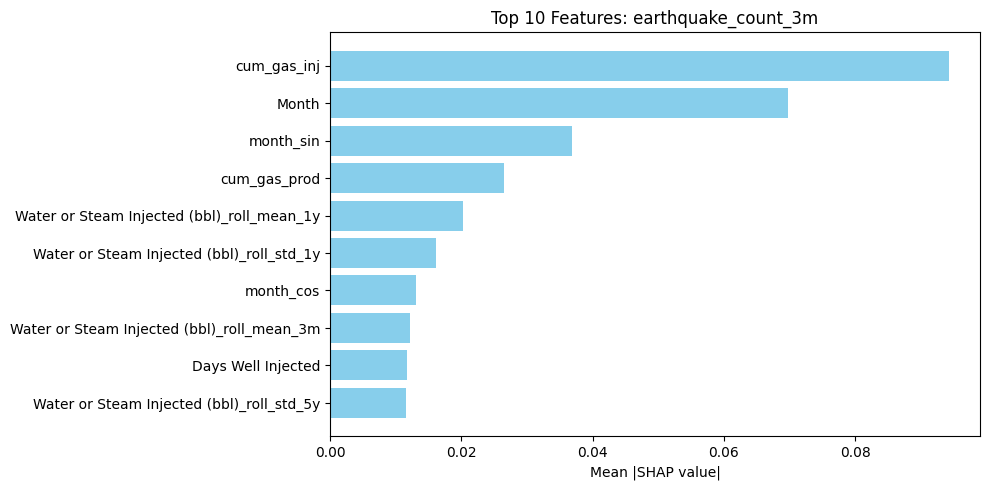

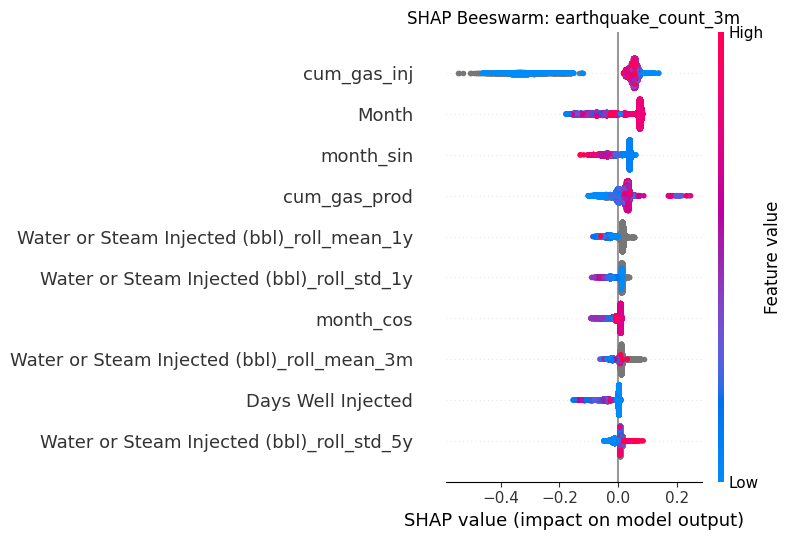

Top 10 features for earthquake_count_3m:
['cum_gas_inj', 'Month', 'month_sin', 'cum_gas_prod', 'Water or Steam Injected (bbl)_roll_mean_1y', 'Water or Steam Injected (bbl)_roll_std_1y', 'month_cos', 'Water or Steam Injected (bbl)_roll_mean_3m', 'Days Well Injected', 'Water or Steam Injected (bbl)_roll_std_5y']

=== SHAP Analysis for earthquake_count_1y ===


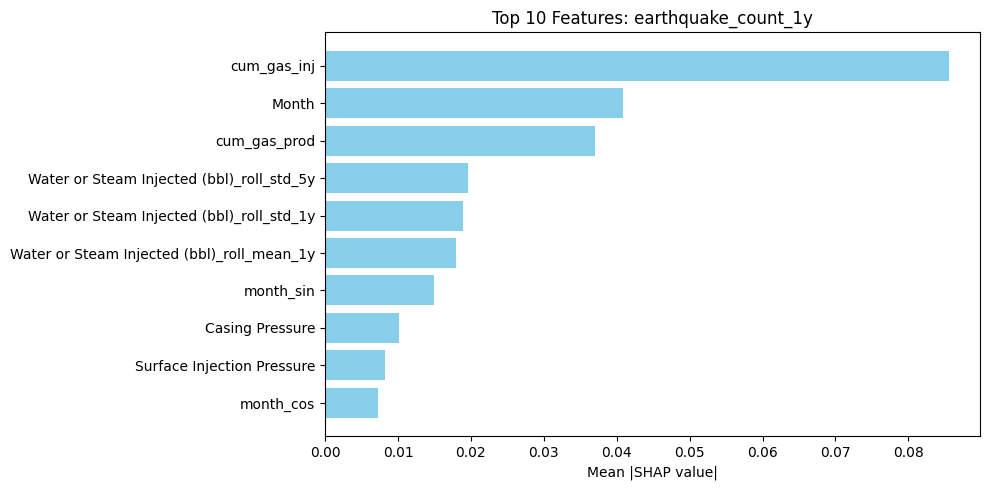

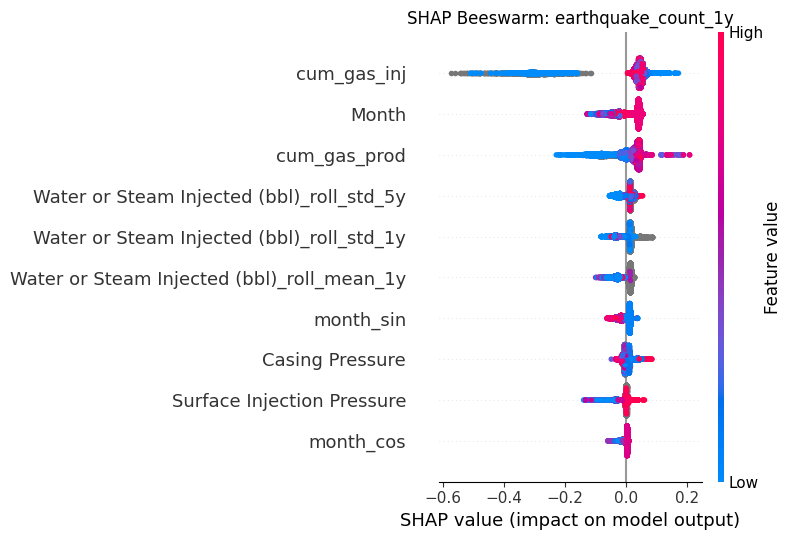

Top 10 features for earthquake_count_1y:
['cum_gas_inj', 'Month', 'cum_gas_prod', 'Water or Steam Injected (bbl)_roll_std_5y', 'Water or Steam Injected (bbl)_roll_std_1y', 'Water or Steam Injected (bbl)_roll_mean_1y', 'month_sin', 'Casing Pressure', 'Surface Injection Pressure', 'month_cos']

=== SHAP Analysis for earthquake_count_5y ===


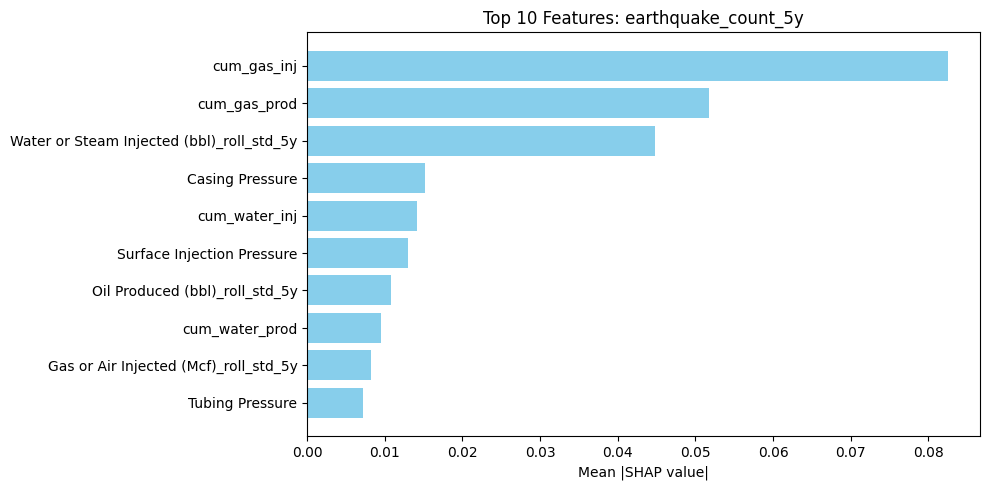

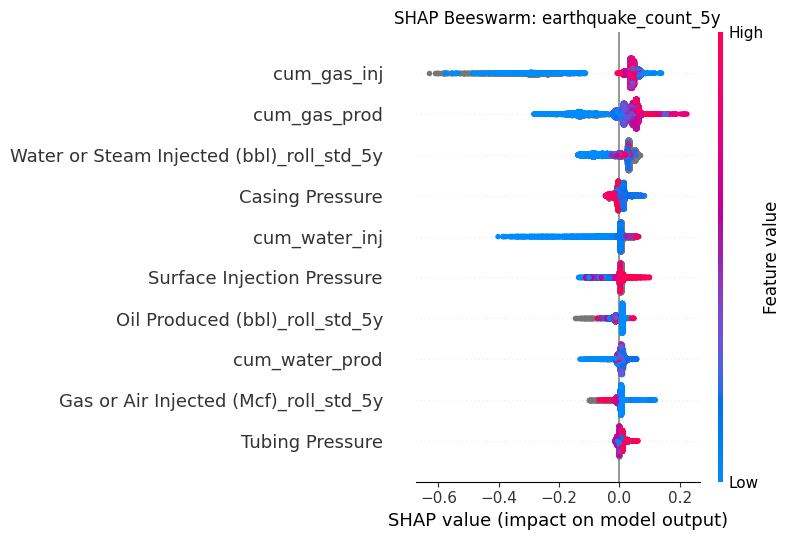

Top 10 features for earthquake_count_5y:
['cum_gas_inj', 'cum_gas_prod', 'Water or Steam Injected (bbl)_roll_std_5y', 'Casing Pressure', 'cum_water_inj', 'Surface Injection Pressure', 'Oil Produced (bbl)_roll_std_5y', 'cum_water_prod', 'Gas or Air Injected (Mcf)_roll_std_5y', 'Tubing Pressure']

=== SHAP Analysis for earthquake_avg_mag_3m ===


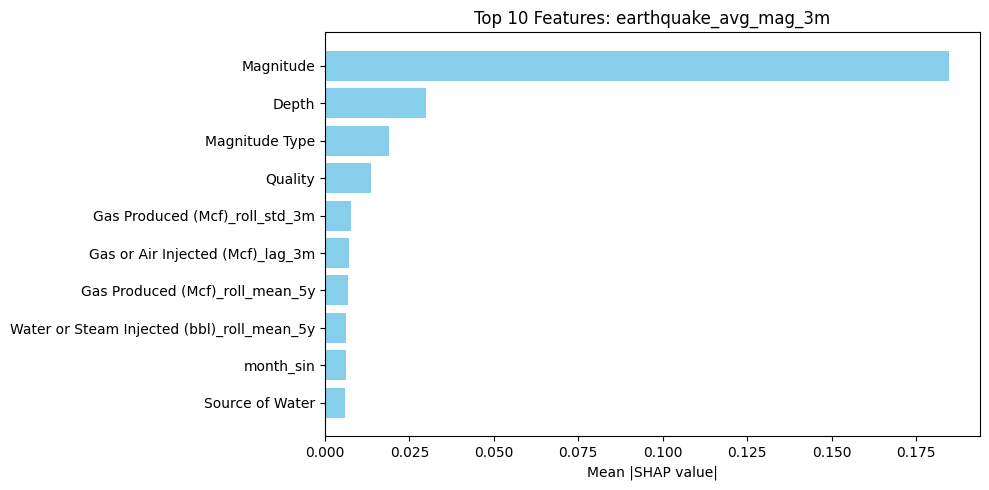

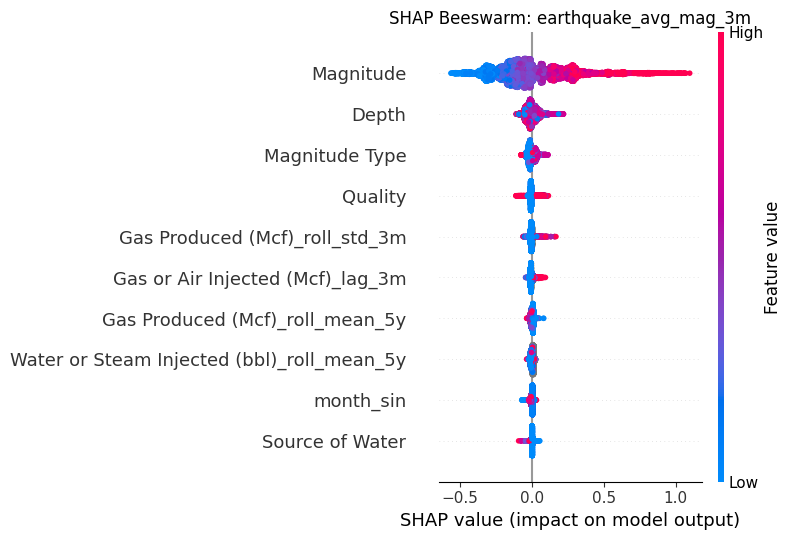

Top 10 features for earthquake_avg_mag_3m:
['Magnitude', 'Depth', 'Magnitude Type', 'Quality', 'Gas Produced (Mcf)_roll_std_3m', 'Gas or Air Injected (Mcf)_lag_3m', 'Gas Produced (Mcf)_roll_mean_5y', 'Water or Steam Injected (bbl)_roll_mean_5y', 'month_sin', 'Source of Water']

=== SHAP Analysis for earthquake_avg_mag_1y ===


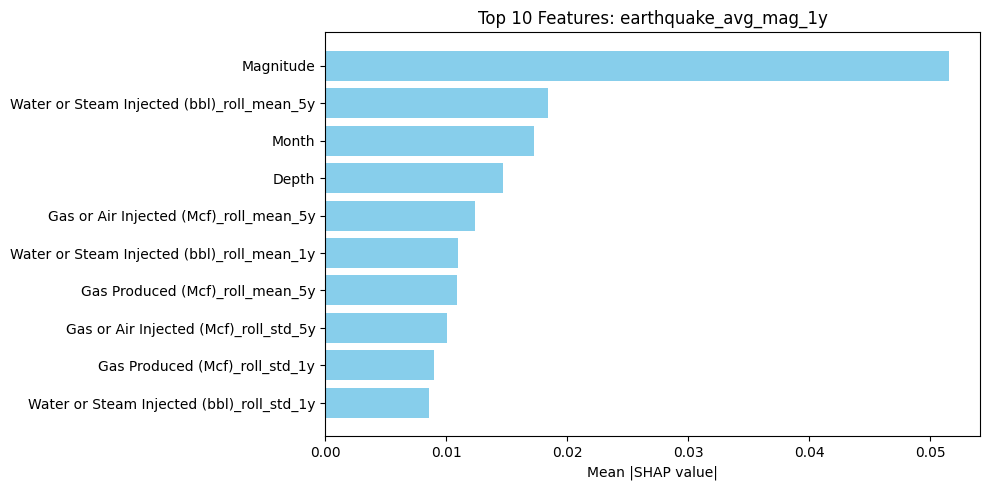

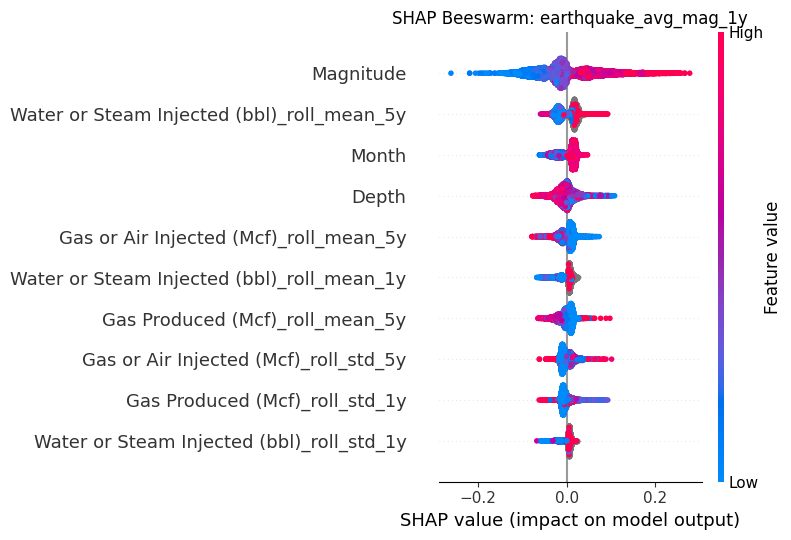

Top 10 features for earthquake_avg_mag_1y:
['Magnitude', 'Water or Steam Injected (bbl)_roll_mean_5y', 'Month', 'Depth', 'Gas or Air Injected (Mcf)_roll_mean_5y', 'Water or Steam Injected (bbl)_roll_mean_1y', 'Gas Produced (Mcf)_roll_mean_5y', 'Gas or Air Injected (Mcf)_roll_std_5y', 'Gas Produced (Mcf)_roll_std_1y', 'Water or Steam Injected (bbl)_roll_std_1y']

=== SHAP Analysis for earthquake_avg_mag_5y ===


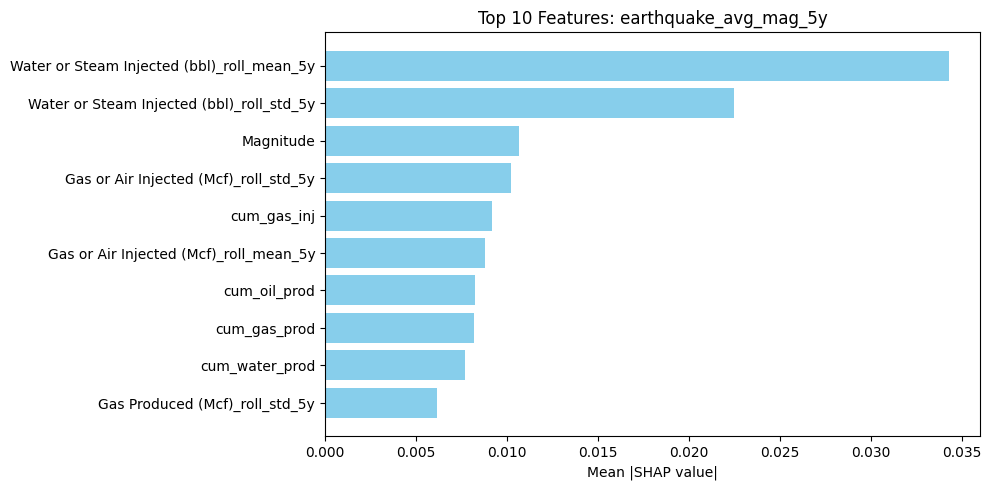

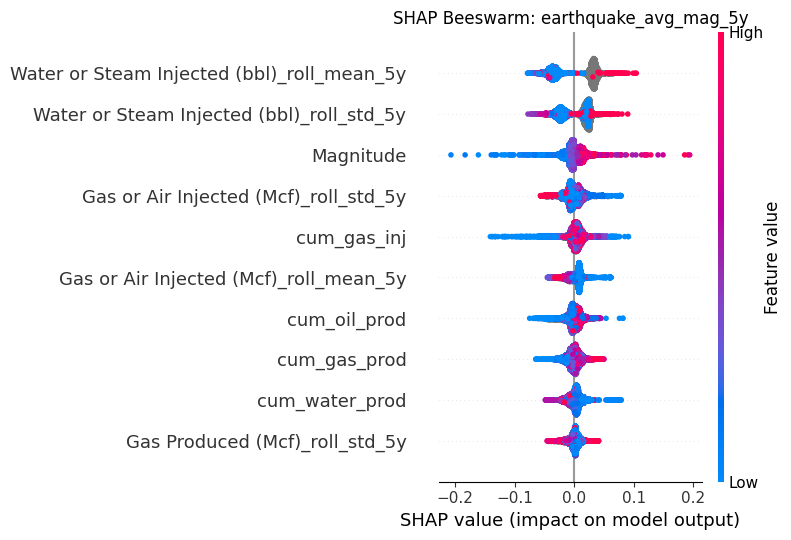

Top 10 features for earthquake_avg_mag_5y:
['Water or Steam Injected (bbl)_roll_mean_5y', 'Water or Steam Injected (bbl)_roll_std_5y', 'Magnitude', 'Gas or Air Injected (Mcf)_roll_std_5y', 'cum_gas_inj', 'Gas or Air Injected (Mcf)_roll_mean_5y', 'cum_oil_prod', 'cum_gas_prod', 'cum_water_prod', 'Gas Produced (Mcf)_roll_std_5y']


In [51]:
os.makedirs("vizs/shap", exist_ok=True)
os.makedirs("xgb_model/results", exist_ok=True)
os.makedirs("xgb_model/results/top10_features", exist_ok=True)

# Convert cat cols to cat codes
X_train_shap = X_train.copy()
for c in cat_cols:
    X_train_shap[c] = X_train_shap[c].cat.codes

top_features = {}

for target, model in models.items():
    print(f"\n=== SHAP Analysis for {target} ===")
    
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_train_shap)
    
    # Top 10 features
    mean_abs_shap = pd.DataFrame({'feature': X_train_shap.columns,
                                  'mean_abs_shap': np.abs(shap_values).mean(axis=0)
                                }).sort_values(by='mean_abs_shap', ascending=False)
    
    top_10 = mean_abs_shap.head(10)
    top_features[target] = top_10['feature'].tolist()
    top_features_lst = top_10['feature'].tolist()
    shap_values_top10 = shap_values[:, [X_train_shap.columns.get_loc(f) for f in top_features_lst]]
    X_top10 = X_train_shap[top_features_lst]

    # Save top 10 features to txt
    top10_file = f"xgb_model/results/top10_features/top10_{target}.txt"
    with open(top10_file, 'w') as f:
        f.write(f"Top 10 features for {target}:\n")
        for feat in top_features[target]:
            f.write(f"{feat}\n")    
    
    # Barplot
    plt.figure(figsize=(10,5))
    plt.barh(top_10['feature'][::-1], top_10['mean_abs_shap'][::-1], color='skyblue')
    plt.xlabel("Mean |SHAP value|")
    plt.title(f"Top 10 Features: {target}")
    plt.tight_layout()
    plt.savefig(f"vizs/shap/{target}_barplot.png")
    plt.show()
    plt.close()
    
    # Beeswarm for top 10 features
    shap.summary_plot(shap_values_top10, X_top10, plot_type="dot", show=False)
    plt.title(f"SHAP Beeswarm: {target}")
    plt.tight_layout()
    plt.savefig(f"vizs/shap/{target}_beeswarm.png")
    plt.show()
    plt.close()
    
    print(f"Top 10 features for {target}:")
    print(top_features[target])

## Predict on full dataset to create prediction maps

In [49]:
# Prediction
os.makedirs("xgb_model", exist_ok=True)
os.makedirs("xgb_model/results", exist_ok=True)

pred_df = df.copy()
# Prepare full feature set 
X_full = df[feature_cols].copy()

for c in X_full.select_dtypes(include='object').columns:
    X_full[c] = X_full[c].astype('category')

full_preds = {}

# Earthquake rate preds
for target in count_targets:
    model = models[target]
    
    y_pred_log = model.predict(X_full)
    y_pred = np.expm1(y_pred_log)
    
    full_preds[target] = y_pred
    pred_df['pred_' + target] = y_pred

# Average earthquake magnitude preds
for target in mag_targets:
    model = models[target]

    y_pred = model.predict(X_full)

    full_preds[target] = y_pred
    pred_df['pred_' + target] = y_pred

# Save the combined predictions 
pred_df.to_csv("xgb_model/results/full_dataset_preds.csv", index=False)

# Save the full dataset model 
joblib.dump(models, "xgb_model/full_dataset_xgb.pkl")

['xgb_model/full_dataset_xgb.pkl']

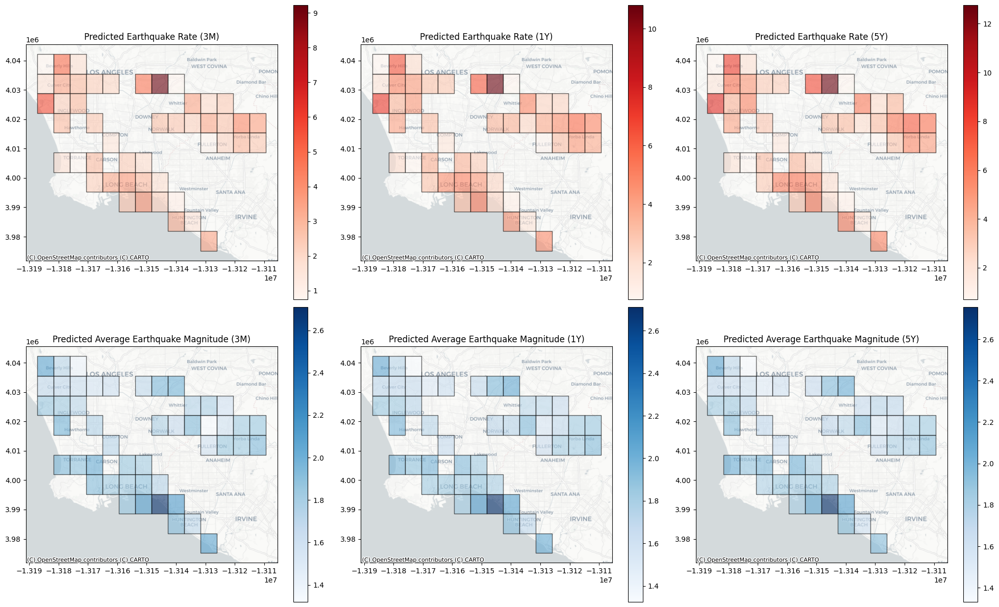

In [ ]:
# Prediction maps
os.makedirs("vizs/pred_maps", exist_ok=True)

# Convert grid_geometry to shapely only if still string
pred_df["grid_geometry"] = pred_df["grid_geometry"].apply(lambda x: wkt.loads(x) if isinstance(x, str) else x)

# Convert to GeoDataFrame
gdf = gpd.GeoDataFrame(pred_df, geometry="grid_geometry", crs="EPSG:4326")

# Aggregate preds by grid_id 
agg_gdf = gdf.groupby("grid_id").agg({"grid_geometry": "first",
                                      **{'pred_'+col: 'mean' for col in count_targets + mag_targets}
                                    }).reset_index()

agg_gdf = gpd.GeoDataFrame(agg_gdf, geometry='grid_geometry', crs='EPSG:4326')
agg_gdf = agg_gdf.to_crs(epsg=3857)  # For basemap

# Plot with LA basemap 
fig, ax = plt.subplots(2, 3, figsize=(20, 12))

agg_gdf.plot(column='pred_'+count_targets[0], cmap='Reds', legend=True, alpha=0.6, edgecolor='k', ax=ax[0,0])
ctx.add_basemap(ax[0,0], source=ctx.providers.CartoDB.Positron)
ax[0,0].set_title(f'Predicted Earthquake Rate (3M)')

agg_gdf.plot(column='pred_'+count_targets[1], cmap='Reds', legend=True, alpha=0.6, edgecolor='k', ax=ax[0,1])
ctx.add_basemap(ax[0,1], source=ctx.providers.CartoDB.Positron)
ax[0,1].set_title(f'Predicted Earthquake Rate (1Y)')

agg_gdf.plot(column='pred_'+count_targets[2], cmap='Reds', legend=True, alpha=0.6, edgecolor='k', ax=ax[0,2])
ctx.add_basemap(ax[0,2], source=ctx.providers.CartoDB.Positron)
ax[0,2].set_title(f'Predicted Earthquake Rate (5Y)')

agg_gdf.plot(column='pred_'+mag_targets[0], cmap='Blues', legend=True, alpha=0.6, edgecolor='k', ax=ax[1,0])
ctx.add_basemap(ax[1,0], source=ctx.providers.CartoDB.Positron)
ax[1,0].set_title(f'Predicted Average Earthquake Magnitude (3M)')

agg_gdf.plot(column='pred_'+mag_targets[1], cmap='Blues', legend=True, alpha=0.6, edgecolor='k', ax=ax[1,1])
ctx.add_basemap(ax[1,1], source=ctx.providers.CartoDB.Positron)
ax[1,1].set_title(f'Predicted Average Earthquake Magnitude (1Y)')

agg_gdf.plot(column='pred_'+mag_targets[2], cmap='Blues', legend=True, alpha=0.6, edgecolor='k', ax=ax[1,2])
ctx.add_basemap(ax[1,2], source=ctx.providers.CartoDB.Positron)
ax[1,2].set_title(f'Predicted Average Earthquake Magnitude (5Y)')

plt.tight_layout()
plt.savefig('vizs/pred_maps/final_preds.png')
plt.show()